<img src="https://upload.wikimedia.org/wikipedia/commons/6/60/NISAR_artist_concept.jpg" width=150/><img src="https://upload.wikimedia.org/wikipedia/commons/9/9b/NISAR_Mission_Logo.png" width=200/> 

***

# NASA ISRO Synthetic Aperture Radar Mission (NISAR)
## Algorithm Theoretical Basis Document for **Forest Disturbance**

Author: Josef Kellndorfer, Earth Big Data LLC

Date: 2022-02-03

### Summary
This notebook describes the ATBD for generating a forest disturbance product from NISAR time series data stacks. The algorithm is designed to meet the Level 2 Science requirements for detecting forest disturbance. This notebook constitutes a combination of formulating the theoretical basis for the NISAR forest disturbance algorithm and a implementation of the algorithm in executable python code. A test data set accompanies the notebook that is publicly available on an cloudbucket and referenced in this notebook. Also accomanying the notebook is a python code library module (`atbd_disturbance.py`)that is imported into this notebook in order for the example of the algorithm to execute within the notebook.

<a id="TOC"></a>
### Table of Contents
1. [Background on forest disturbance and Level 2 science requirement](#SEC_1)
2. [Discussion on NISAR time series signal sensitivity to forest disturbance](#SEC_2)
3. [Implementation and calibration approach for algorithm](#SEC_3)
    1. [Seasonal sub-setting of time series data stack](#SEC_3A)
    2. [Relative calibration of  subsetted time series data stack](#SEC_3B)
    3. [Change point detection with cumulative sum analysis](#SEC_3C)
    4. [Generation of the NISAR disturbance product](#SEC_3D)
    5. [ Products to retain](#SEC_3E)
4. [Example of algorithm application of NISAR simulated data (from a three-year ALOS-2 Scansar time series)](#SEC_4)
    1. [Data set input](#SEC_4A) 
    2. [Generate a forest mask for a baseline year](#SEC_4B)
    3. [Check for seasonality](#SEC_4C)
    4. [Change point detection with cumulative sum analysis](#SEC_4D)
    5. [Generation of the NISAR disturbance product from the change point data set](#SEC_4E)
5. [Discussion of validation of NISAR forest disturbance algorithm](#SEC_5A)
    1. [Approach to validation with VHR data](#SEC_5A)
    2. [Example of generation of reference data from VHR data](#SEC_5B)
6. [References](#SEC_6)

### List of Figures
- [Figure 1: Distribution of global ecoregions and biomes](#FIG_1)
- [Figure 2. Algorithmic flow of disturbance detection with NISAR time series data](#FIG_2)
- [Figure 3. Example of ALOS-1 time series and cumulative sum curves](#FIG_3)
- [Figure 4: Example region in Rhondonia, Brazil. (Image source: Bing.com)](#FIG_4)
- [Figure 5: Minumum backscatter at each pixel in the reference year in L-HV polarization](#FIG_5)
- [Figure 6: Forest mask in the reference period derived from thresholding](#FIG_6)
- [Figure 7: Forest mask (left) in the reference period derived from thresholding the year 2018 minimum image (right).](#FIG_7)
- [Figure 8: Comparison of the 2018 Minimum Image with a selected date in the time series.](#FIG_8)
- [Figure 9: Subsetted data stack with the forest mask applied.](#FIG_9)
- [Figure 10: Monthly backscatter means over forest in the data stack.](#FIG_10)
- [Figure 11: Forest Disturbance event in mid 2019. Time series backscatter, residuals and S curves.](#FIG_11)
- [Figure 12: Forest Disturbance event in late 2020. Time series backscatter, residuals and S curves.](#FIG_12)
- [Figure 13: Comparison of the reference values for residual calculation.](#FIG_13)
- [Figure 14: $S_{DIFF}$ image (left) and its histogram (right).](#FIG_14)
- [Figure 15: $S_{DIFF}$ image masked by the  percentile threshold.](#FIG_15)
- [Figure 16: Confidence level and derived masks after bootstrapping the process of change point detection.](#FIG_16)
- [Figure 17: Interactive Visualization of the S curves at the detected change points.](#FIG_17)
- [Figure 18: Visualization of change point dates.](#FIG_18)
- [Figure 19: Count of disturbed 20 m pixels in one-hectare cells. Example for year 2019.](#FIG_19)
- [Figure 20: NISAR simulated disturbance products at 100 m (bottom row) derived from coarsening the 20 m products (top row).](#FIG_20)

<a id="SEC_1"></a>
## 1. Background on forest disturbance and Level 2 science requirement

Accurate annual measurements of the global area of forest disturbance from NISAR will be a significant contribution to the global accounting of carbon emissions from land cover change (van der Werf et al., 2009).
The NISAR disturbance product complements the NISAR biomass, inundation, and active agricultural area products to jointly improve our understanding of carbon emissions from land cover change and the success
of mitigation strategies like avoided deforestation. As such, the disturbance product from NISAR will constitute an invaluable contribution to the accounting needs for the United Nations negotiated policy mechanism
for Reducing Emissions from Deforestation and Forest Degradation (REDD) as well as emerging bi- and multilateral carbon treaties involving forest carbon accounting (Romijn et al., 2012; Baker et al., 2010). To date, forest carbon accounting with remote sensing methods has made significant progress and international efforts by the Committee on Earth Observing Systems (CEOS) and the GEO Global Forest Observing Initiative (GFOI) strive to improve national efforts on Forest carbon Monitoring, Reporting and Verification (GFOI, 2013). As cloud-cover is a major impediment to reliably acquiring high-spatial resolution annual data sets with optical sensors over tropical, sub-tropical and boreal regions, SAR observations have emerged as a critical complement (Walker et al., 2010; Kellndorfer et al., 2014; Reiche et al., 2016). Achieving reliable and timely accounting of forest disturbance globally at consistent annual or even sub-annual intervals will improve our scientific understanding of global carbon emission dynamics from forests, both from natural and anthropogenic disturbances.

The NISAR L2 science requirement for forest disturbance is expressed as:

```
The NISAR project shall measure global areas of vegetation disturbance at 1 hectare resolution annually for areas losing at least 50% canopy cover with a classification accuracy of 80%.
```

[back to TOC](#TOC)

<a id="SEC_2"></a>
## 2. Discussion on NISAR time series signal sensitivity to forest disturbance

The NISAR disturbance detection algorithm is based
on time series analysis techniques of observed NISAR L-band calibrated backscatter measurements, foremost using cross-polarized observations (L-HV). 
 
At its core, the algorithm is analyzing backscatter time series over an observation length of one year compared to a baseline year for subsequent observations from NISAR. Year one of NISAR acquisitions will establish the baseline for observations and subsequent years will assess change against this baseline year. Observations in the time series may be temporally segmented (e.g., freeze/thaw, wet/dry season observations only), determined spatially based on the observational data to account for ecosystem specific seasonality (see [Figure 1](#FIG_1)). A simple, yet robust, approach for detecting disturbance in these time series of backscatter images is based on change point detection with cumulative sums analysis which have been employed in many sectors such as statistical control, financial trends and meteorological analysis. During the NISAR mission, time series-based cumulative sums are calculated for each 20 m pixel, either from the full year observation period, or from seasonally segmented subsets, which is adequate in complex biomes like the boreal or temparate regions with strong freeze-thaw or tropical wet season  seasonality. While the NISAR Level 2 Science requirement needs verification at the annual level, the algorithm can be used to produce viable results from observations of shorter periods in the time series. As such, the algorithm will be applicable in several biomes even after a shorter inital obsevation period of several month after commissioning phase of the NISAR mission. 

<a id="FIG_1"></a>
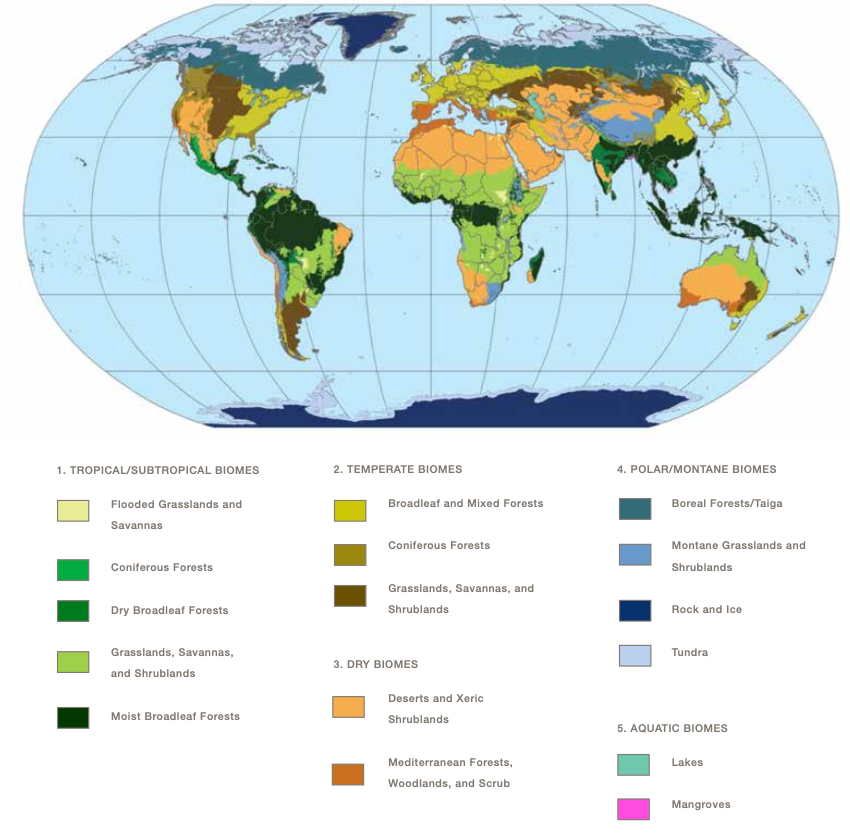

*Figure 1. Distribution of global ecoregions and biomes for the development of the vegetation biomass algorithm. The ecoregions are derived from a combination of climate, topography, soil and vegetation data (Olson et al., 2001). The focus of the CAL/VAL plan and algorithm development would be on biomes that have distinct differences in seasonality influencing backscatter at L-HV, e.g. from boreal and temparate freeze-thaw transitions or tropical wet seasons.*

At its core, L-band cross-polarized backscatter exhibits a significant backscatter drop (several dB), depending on initial state of canopy density and forest structure, when forest fractional canopy cover is reduced by 50% or more (Cartus et al.,2018).

In order to provide a more theoretical foundation for the use of time series analysis of backscatter change based on the target scattering physics, a theoretical scattering model has been developed and described (Cartus et al., 2018). This model includes the scattering model and an observational error model, in order to show the separation between simulated natural and disturbed forest canopies. A summary of this simple observational model tailored for disturbance (i.e., ignoring double bounce) using cross-polarized observations is given here.



In a relationship between radar observation and classification accuracy, an error model is needed for the observations and those components that contribute to the target radar cross section (RCS). The observational error model that relates the observed radar crosssection, for each polarization *pq (HH or HV)* , written here as $\sigma^0_{obs}$ for simplicity, to the observation error sources, $\sigma^0_{obs-error}$ and the radar cross-section of a forest canopy, $\sigma^0_{forest}$ is

\begin{align}
\sigma^0_{obs} = \sigma^0_{obs-error} + \sigma^0_{forest}\label{eq1}\tag{1}
\end{align}

The observational errors consist of instrumental effects, such as calibration and quantization errors, observational ambiguities, and speckle noise. With these factors taken into account, the radar crosssection of the forest can be written as

\begin{align}
\sigma^0_{forest} = \left(1-\eta\right) \sigma^0_{ground} + \eta\left[  \sigma^0_{ground}e^{-{\alpha}h} + \sigma^0_{veg}\left(1-e^{-{\alpha}h}\right)\right]   \label{eq2}\tag{2}
\end{align}

which is an “infinite resolution” model borrowed from optical techniques, where the contribution of the ground surface  $\sigma^0_{ground}$ is combined with the average return from a layer of vegetation, $\sigma^0_{veg}$, weighted by the fraction of vegetation canopy cover, $\eta$. In the above, the two-way loss of signal energy as it passes through the canopy is accounted for by $\alpha$, the extinction, and a vegetation height (h) estimate. $\alpha$ is normally given in units of $dB/m$.

The above equation can be rearranged so as to separate the ground and the vegetation scattering returns, as in


\begin{align}
\sigma^0_{forest} = \sigma^0_{ground}\left[1-\eta\left(1-e^{-{\alpha}h}\right)\right] + \sigma^0_{veg}\left[\eta\left(1-e^{-{\alpha}h}\right)\right]     \label{eq3}\tag{3}
\end{align}


When multiple observations are made, (1) through (3) can be combined to relate the vector of observations to the spatially varying values and the set of constants that describe the mean radar cross section of the ground
and vegetation, as in

\begin{align}
\begin{bmatrix}
    \sigma^0_{obs_1}\\
    \sigma^0_{obs_2}\\
    \vdots\\
    \sigma^0_{obs_N}
\end{bmatrix}=
\begin{bmatrix}
    1-\eta_1\left(1-e^{-{\alpha}h}\right) & \eta_1\left(1-e^{-{\alpha}h}\right) \\
    1-\eta_2\left(1-e^{-{\alpha}h}\right) & \eta_2\left(1-e^{-{\alpha}h}\right) \\
    \vdots & \vdots\\
    1-\eta_N\left(1-e^{-{\alpha}h}\right) & \eta_N\left(1-e^{-{\alpha}h}\right) \\
\end{bmatrix}
\begin{bmatrix}
    \sigma^0_{ground}\\
    \sigma^0_{veg}
\end{bmatrix}
\label{eq4}\tag{4}
\end{align}

which, for a given number of observations, N, can be inverted to estimate the radar cross section of the ground and vegetation returns. Through simulations with real ALOS-1 L-band measurements with estimates for h and $\eta$ from ancillary data sources, the validity of backscatter-based change detection of 50% canopy density loss was demonstrated for the project in a memorandum by Siqueira et al. (2014). Time series analysis allows for the minimization of error sources from soil and vegetation moisture as well as speckle noise variations.


[back to TOC](#TOC)

<a id="SEC_3"></a>
## 3. Implementation and calibration approach for algorithm

Pre-requisites for the disturbance detection algorithm are fully calibrated, radiometrically terrain corrected (RTC) backscatter time series where pq=HV. Co-polaized data (pq=HH) are useful for identifying potential ambiguities and unsupervised clustering and are employed to mask non-forest areas such as wetlands and agricultural areas. The results from the ecosystems algorithms for inundation and agriculture detection can be used as masked areas for disturbance mapping.

NISAR time series data constitute 12-day repeat observations of RTC image data calibrated to $\gamma^0$ following the standard of the *NISAR GCOV* product. Just like for all ecosystems disciplines, $\gamma^0$ (gamma naught) is preferable over $\sigma^0$ due to the "flattening" of the terrain effects in the products this mitigating incidence angle based effects on backscatter. The theoretical basis of backscatter sensitivity for  disturbance detection discussed in [Section 2](#SEC_2) apply to the $\gamma^0$ calibration. 

The time series RTC products are subjected to multi-temporal speckle noise reduction according to Quegan et al., 2001. A diagram giving the processing flow for the disturbance algorithm is shown in [Figure 2](#Fig_2).

<a id="FIG_2"></a>
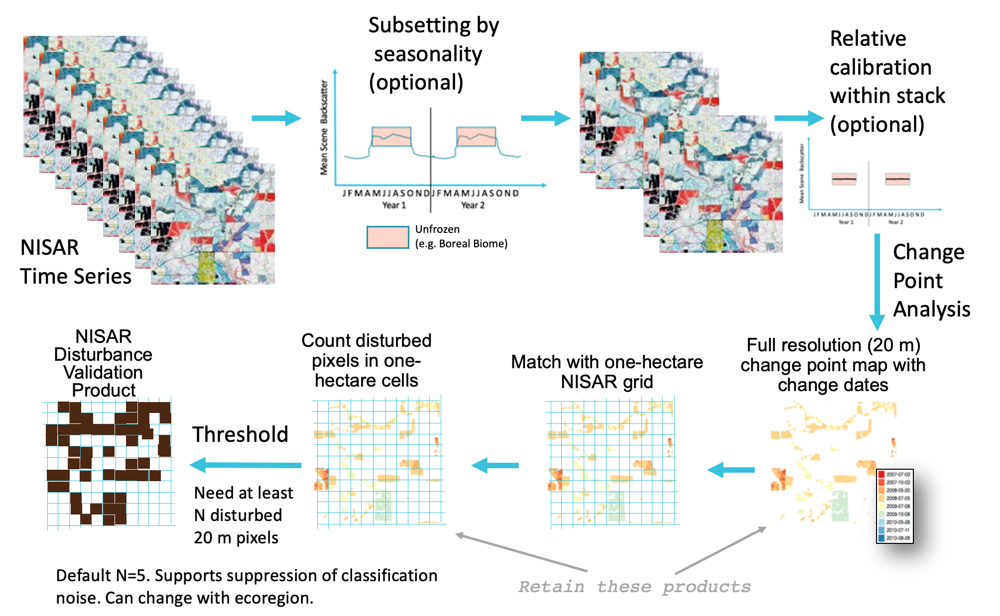

*Figure 2. Algorithmic flow of disturbance detection with NISAR time series data based on change point analysis.*

[back to TOC](#TOC)

<a id="SEC_3A"></a>
### 3.A Seasonal sub-setting of time series data stack

For many biomes, seasonal stratification of time series will improve detection of disturbance events, e.g., where freeze/thaw or dry/wet season conditions introduce significant backscatter changes. Thus, the first step in the disturbance detection algorithm is the sub-setting of time series data stacks and selection of scenes to minimize gross environmental effects on backscatter levels. Selection of the scenes can be performed with a global scene means comparison and threshold approach as follows:

1. A crude forest/non-forest mask is generated for a time series data stack. This mask can be  obtained from ancillary existing land cover classifications (e.g., based on MODIS, Landsat, ALOS-1, Sentinel-1/2), or by thresholding an minimum (i.e. driest conditions) HV SAR image from a subset of data in a typical season of interest (e.g., non-frozen, dry season). Example for a crude forest mask from SAR is a thresholding approach being used to generate  a forest mask from ALOS-1 and 2 L-HH/HV data sets (Shimada et al., 2014). In addition to a global backscatter threshold, the coefficient of variation can be employed to maks undisturbed areas in the reference period (see ATBD for agriculture). 
2. For all pixels $t_i$ under the mask, the mean (on the power scaled data) at each time step $i = 1...n$ is generated to produce a time series of means as: $t_{mean} = \{\bar{t_1}, \bar{t_2}, \bar{t_3},..., \bar{t_n}\}$.
3. Here, $t_{mean}$ is a collection of mean values, where $t_i$ indicates the mean pixel value for the forested pixels in the image. This is a large-scale assessment of the seasonal effects within the image. If $max(t_{mean}) - min(t_{mean}) < 1dB$, we shall not need to split the time series into seasonal subsets. Otherwise we proceed:
4. $t_{mean}$ is sorted from low to high values.
5. The gradient for the sorted $t_{mean}$ is computed as ${\nabla}t_{mean}$.
6. A threshold for significant major backscatter change is applied to the gradient of the sorted time series means such that subset(${\nabla}t_{mean}$) = ${\nabla}t_{mean}$ > change_threshold. The change_threshold for each biome is established as a calibration effort after one years of time series data from NISAR or from ALOS-2 (pre-launch) are available. In regions undergoing freeze/thaw transitions, the threshold will be set to select non-frozen (high backscatter) conditions; in regions with wet/dry seasons, the subset will be chosen from dryer (low backscatter) conditions as we expect a stronger signal variations in these respective conditions.
7. NISAR images that correspond to time steps in the subset from step 5 (or the complement of subsets) are selected to form the time series for change detection analysis.

Both the forest mask and change threshold can be estimated per ecosystem from statistical analysis with canopy density masks. During the NISAR mission we will generate a lookup table for biomes and ecoregions for these thresholds.

[back to TOC](#TOC)

<a id="SEC_3B"></a>
### 3.B Relative calibration of  subsetted time series data stack

For improved results, the data from each acquisiton date in the time series stacks could be  calibrated relative to each other to achive a higher relative backscatter stability by eliminating largly moisture induced backscatter variations in otherwise unchanged forest targets. This calibration step examines distributed forest targets that are expected to be unchanged or minimally changed in brightness over a set time span of images. With NISAR’s 240 km swath width, it
is reasonably assumed that a statistically large area, $A_{ni}$, will not be disturbed (or otherwise changing) during any of the observations in the subsetted time series observations. These areas will be identified partly through use of the threshold-based forest mask from one scene and applied again through all images.

The relative calibration factor for image n, $f_n$ , for each polarization channel pq, is

\begin{align}
f_{n,pq}=\frac{\overline{(\gamma^0_{pq}(A_{ni}))_t}}{\overline{(\gamma^0_{n,pq}(A_{ni}))}}\label{eq5}\tag{5}
\end{align}

where $\overline{(\gamma^0_{pq}(A_{ni}))_t}$ 
is the average $\gamma^0$ over the area $A_{ni}$ for all images over the timespan t corresponding to the selected images according to the procedure above, and $\overline{(\gamma^0_{n,pq}(A_{ni}))}$ is the average $\gamma^0$ over the area $A_{ni}$ for the image n. Image values for the refined calibration of image n for each polarization channel, $\gamma^{0'}_{n,pq}$, will be given
by 

\begin{align}
\gamma^{0'}_{n,pq} = f_{n,pq} \gamma^0_{n,pq} \label{eq6}\tag{6}
\end{align}


After having acquired a full year time series data stack from NISAR we will revisit this calibration step and evaluate it's relavtive merits to be performed. Application of this step is foremost useful of large system based variations are detected. However, given NISAR's calibration requirement, we do not expect this step to be necessary in the data pre-processing.

[back to TOC](#TOC)

<a id="SEC_3C"></a>
### 3.C Change point detection with cumulative sum analysis

Inital disturbance detection in the time series data stack will be the result of a cumulative sum analysis performed for (20m) each pixel in the time dimension.
Cumulative sum analysis of time series is the basis for classical change point detection via mean shift detection that investigates the change in mean before and after a change in a time series (Schweder et al., 1976). It is a distribution-free approach, applicable to short, irregular time series for detecting gradual and sudden changes. A graphical example of this process is shown in [Figure 3](#FIG_3).

<a id="FIG_3"></a>
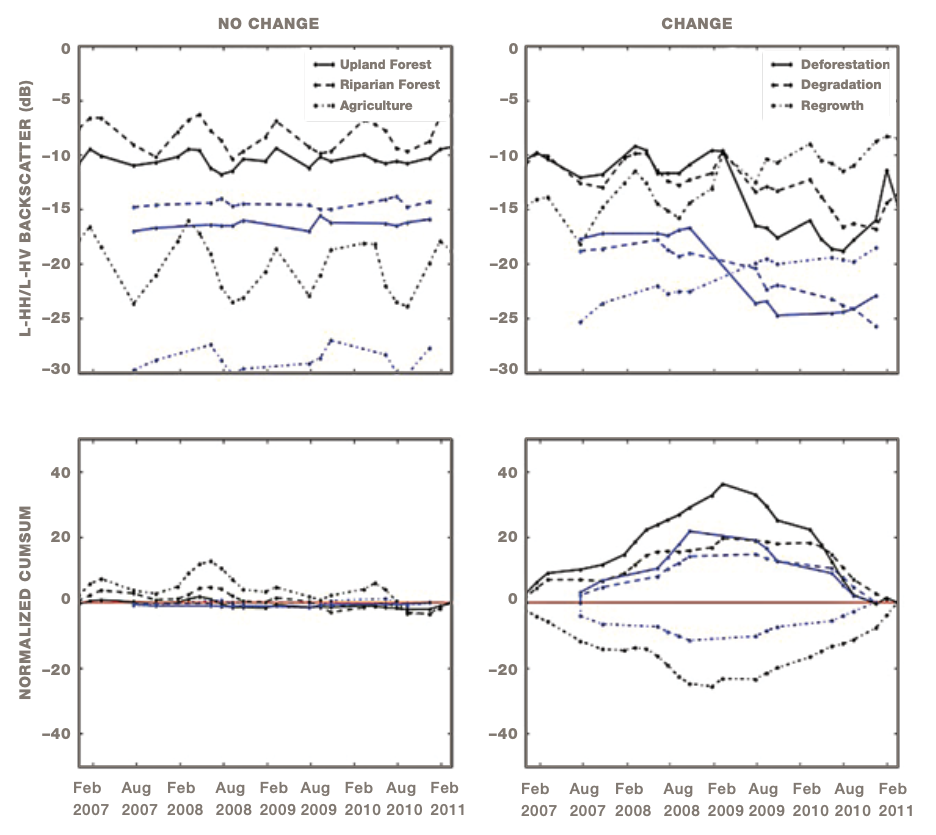

*Figure 3. Example of ALOS-1 time series (top) for various unchanged (left) and changed (right) land cover types. Bottom figures show the corresponding cumulative sum curves. Black lines refer L-HH polarization, blue lines to L-HV polarization.*

#### Building cumulative sum curves

Let $X$ be the time series of the subset of n selected scenes as

\begin{align}
    X = (X_1,X_2,...,X_n) \label{eq7}\tag{7}
\end{align}

with

- $X_i$  SAR backscatter at time $i=1,...,n$
- $n$ number of observations in the time series

The residuals $R_i$ of the time series against the mean are computed as

\begin{align}
R_i = X_i -\overline{X}\label{eq8}\tag{8}
\end{align}

Alternatively, residuals $R_i$ of the time series can be computed against the geometric mean $\overline{X_g}$ of the maximum  and minimum values in the time series

\begin{align}
\overline{X_g} =  \frac{max(X)+min(X)}{2}\label{eq8a}\tag{8a}
\end{align}

\begin{align}
R_i = X_i - \overline{X_g}\label{eq8b}\tag{8b}
\end{align}

This approach has the advantage that the peak (maxima) of the cumulative sum of the $R_i$ is independent of the temporal occurence of the change. Thus, applied thresholds to constrain analysis based on the maximum or minimum values in the cumulative sum curve (9) are more consistent over time.

From the time series of the residuals $R_i$ we compute the time series of the cumulative sum of the residuals, $S_i$, which can be plotted for visual analysis as in [Figure 3](#FIG_3):

\begin{align}
S_i = S_{i-1} + R_i \label{eq9}\tag{9}
\end{align}

  with $i=1,...,n$ and $S_0=0$

#### Identifying change points

In the cumulative sum curve, the slope of $S$ is indicative of change in a time series:
- Upward slope: Values are above the estimated mean ($\overline{X}$ or $\overline{X_g}$)
- Downward slope: Values are below estimated mean
- Change in slope direction: Indication of change point location

Because of the relative short observation span (baseline year plus subsequent year for NISAR annual product validation) and the comparatively slow regrowth rates of forests, only the detection of primary changepoints is of concern. Were the analysis applied to time series spanning multiple years, time series should be analyzed in segments of two to three years in order to detect potentially multiple change events stemming from regrowth and redisturbance events.    

An estimator for the magnitude of change is given as the difference between the maximum and minimum value of S as

\begin{align}
S_{DIFF} = max(S) - min(S)\label{eq10}\tag{10}
\end{align}

The location of the changepoint in the time series is to be taken into consideration when using $\overline{X}$ instead of $\overline{X_g}$ to calculate the residuals $R$. Everything else being equal, in this case, change events with backscatter drop early or late in a time series will have lower $S_{DIFF}$ values than the $S_{DIFF}$ values in the center of a time series. Thus, preference is given to apply (8b) for the calculation of $R$. 

At any one point in time larger $S_{DIFF}$ values are indicative of stronger change (backscatter drop) compared to lower $S_{DIFF}$ values observed at the same point in time.

A candidate change point is identified from the $S$ curve at the time where $S_{MAX}$ is found:

\begin{align}
T_{{CP}_{before}} = T(S_i = S_{MAX})\label{eq11}\tag{11}
\end{align}

with

- $T_{{CP}_{before}}$ Timestamp of last observation before detected change
- $S_i$    Cumulative Sum of R with $i=1,...n$
- $n$      Number of observations in the time series 

The first observation after change occured ($T_{{CP}_{after}}$) is then found as the first observation in the time series following $T_{{CP}_{before}}$. 


#### Verifying change points by bootstrapping the cumulative sum analysis

We can determine if an identified change point is indeed a valid detection by randomly reordring the time series and comparing the various S curves. During this bootstrapping approach we count how many times the $S_{DIFF}$ values are greater than $S_{{DIFF}_{random}}$ of the identified change point. A confindence level $CL$ is computed as

\begin{align}
CL = \frac{N_{GT}}{N_{bootstraps}}\label{eq12}\tag{12}
\end{align}

with 

- $N_{GT}$    Number of times $S_{DIFF}$ > $S_{{DIFF}_{random}}$  
- $N_{bootstraps}$    Number of bootstraps randomizing $R$ in the time dimension

After bootstrapping we can filter the resulting CL map with a threshold which ultimately determines the identified change pixels. 


\begin{align}
D^{20}_{x,y} = CL_{x,y} >= threshold\label{eq13}\tag{13}
\end{align}

with

- $D^{20}_{x,y}$ Flag for disturbance (change) at pixel location x and y, 0 or 1 value.
- $CL_{x,y}$ confidence level value from bootstrapping at pixel location x and y. 

The most conservative threshold is 100%.



Through analysis of the $S$ curve we can also determine the identified change dates. This is accomplished by convolution of $S$ with $D$ (as a mask with values 0 or 1), and applying the `argmax` operator to produce a **change point timestamp map** ($T_{CP}$) as

\begin{align}
T_{CP_{x,y}} = argmax\left(S_{x,y}{D^{20}_{x,y}}\right)+1\label{eq14}\tag{14}
\end{align}

with

- $T_{CP_{x,y}}$ Timestamp (as band number) for change point detected at pixel location x and y
- $S_{x,y}$ cumulative sum S time series vector at pixel location x and y


[back to TOC](#TOC)

<a id="SEC_3D"></a>
### 3.D Generation of the NISAR Disturbance Product

Analysis of change point detection is performed at 20 m pixel spacing. The thresholded confidence level map, $D^{20}_{x,y}$ in (13), determines for each pixel whether we see forest disturbance (i.e. a change point detected) in that pixel. Hectare scale maps $D^{100}$ will be generated by spatially aggregating the  20x20 sqm disturbance map $D^{20}$ resulting from (13) in groups of 5x5 pixels to a 100x100 sqm grid. During aggregation, all $D^{20}_{x,y}$ in the 25 pixels are summed up. Thus, any given hectare cell $D^{100}_{x,y}$ value can range from 0 (no pixel was flagged as changed) to 25 (each pixel was flagged as changed) from (13).  

\begin{align}
{D}^{100}_{x,y} = \sum_{c=1}^{5}\sum_{r=1}^{5}D^{20}_{x,y,c,r}\label{eq15}\tag{15}
\end{align}

with

- $D^{20}_{x,y,c,r}$ disturbance flag (0 or 1) in hectare cell at pixel location x and y 
- $c,r$ column and row coordinates in the 5x5 $D^{20}$ matrix contained in the $D^{100}_{x,y}$ hectare cell


In order to reduce classification noise in the 20x20m $D^{20}$ map, a threshold will be applied to flag any $D^{100}_i$ cell as disturbed or not in the final **NISAR disturbance validation** binary product ${NDV}$,

\begin{align}
{NDV}^{100}_{x,y} = D^{100}_{x,y} >= {threshold}\label{eq16}\tag{16}
\end{align}

with
$threshold = 5$ as default, adjustable by ecoregion.

We will flag any one-hectare unit as disturbed if a at least a threshold number of pixels from the CL map are identified as changed. We might adjust the number of pixels during cal/val operations. 



Validation of our flagged hectare scale product (which will have a pixel count of disturbed 20 m pixels) is to demonstrate that we detect any 1 hectare cell where 50% or more canopy cover was lost. This analysis is done with the aid of VHR optical or SAR data analysis. 

[back to TOC](#TOC)

<a id="SEC_3E"></a>
### 3.E Products to retain

The final products to retain from the analysis process are $T_{CP}$ from (14) and $D^{100}$ from (15). 

$D^{20}$ can readily be derived from  $T_{CP}$ with

\begin{align}
D^{20}_{x,y} = T_{CP_{x,y}}  > 0\label{eq17}\tag{17}
\end{align}

${NDV}^{100}$ can always be readily derived from $D^{100}$ with (16).

[back to TOC](#TOC)

<a id="SEC_4"></a>
## 4. Example of algorithm application of NISAR simulated data (three-year ALOS-2 ScanSAR time series)

<a id="SEC_4A"></a>
### 4.A Data set input 
From ALOS-2 we have an example time series data stack over the region of Rhondinia in Brazil which is renowned for its dynamic deforestation in a fishbone pattern. Figure 4 shows the region from an optical satellite perspective. 

<a id="FIG_4"></a>
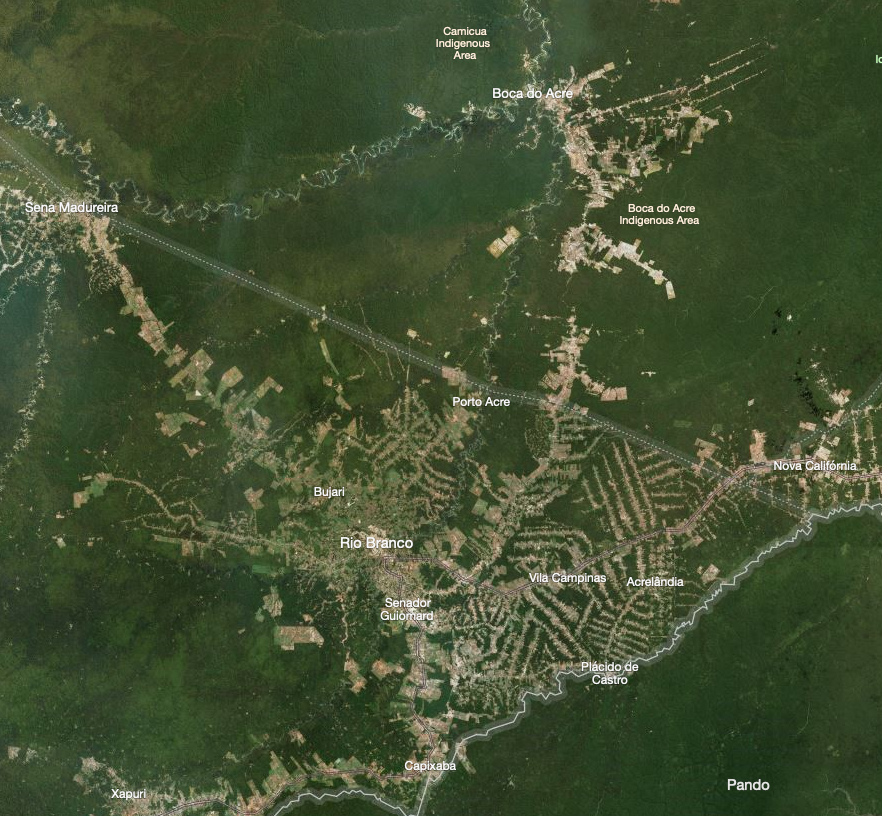

*Figure 4: Example region in Rhondonia, Brazil. (Image source: Bing.com)*

The data stack for this example has been processed to HH and HV  backscatter values ($\gamma^0$) at 50 m resolution (0.005 arcseconds) with the Copernicus 30 m DEM for radiometric terrain correction (RTC). The ALOS-2 cover the period

In [1]:
develop_run=False # Set to true if the notebook is tested instead of fully executed
##########################################################################
# Import python modules via the atbd_disturbance.py modules
##########################################################################
import sys,os
sys.path.append(os.getcwd()) # We assume the file is in the same directory as the notebook
from atbd_disturbance import *



In [2]:
local_data=True
##########################################################################
# dataroot to Bucket and path to the data sets
##########################################################################
if local_data:
    dataroot=os.path.join(os.environ['HOME'],'Dropbox/Data/SAR/alos-2/RTC/WBD/mtfil/2000ppd')  #local copy
else:
    dataroot='alos-2/RTC/WBD/mtfil/2000ppd'  #s3 bucket

In [3]:
##########################################################################
# Default stretch boundaries for SAR power data 
##########################################################################
dclim={
    'hh':(0.01,0.1),
    'hv':(0.005,0.03)
    }  

In [4]:
##########################################################################
# Set parameters to access data on the cloud bucket
##########################################################################
profile ='default'  # Change to a profilename if default is not used
region  ='us-west-2'
endpoint='s3.us-west-2.amazonaws.com'
endpoint_url='https://'+endpoint
os.environ['AWS_S3_ENDPOINT']=endpoint
os.environ['AWS_DEFAULT_PROFILE']=profile
os.environ['AWS_S3_REGION']=region
os.environ['AWS_DEFAULT_REGION']=region
os.environ['AWS_REGION']=region

In [5]:
# Retrieve key and secret key from the aws credentials file
with open(os.path.join(os.environ['HOME'],'.aws/credentials'),'r') as f:
    credentials=f.read()
os.environ['AWS_ACCESS_KEY_ID'] = credentials.split(profile)[1].split(' = ')[1].split('\n')[0]
os.environ['AWS_SECRET_ACCESS_KEY'] = credentials.split(profile)[1].split(' = ')[2].split('\n')[0]

In [6]:
if local_data:
    fs = fsspec.filesystem('')
else:
    fs = fsspec.filesystem('s3',anon=False,profile=profile,client_kwargs={'endpoint_url':endpoint_url})

In [7]:
if not local_data:
    ##########################################################################
    # We are starting a kubernetes cluster here. This cell can be skipped if working without a cluster
    ##########################################################################
    sys.path.append(os.path.join(os.environ['HOME'],'shared','users','lib'))
    import ebdpy as ebd
    # Optimize gdal use
    os.environ['GDAL_DISABLE_READDIR_ON_OPEN']='EMPTY_DIR'
    os.environ['CPL_VSIL_CURL_ALLOWED_EXTENSIONS']='tif,vrt,TIF,vrt'
    os.environ['VSI_CACHE']='TRUE'
    env_vars=['GDAL_DISABLE_READDIR_ON_OPEN','CPL_VSIL_CURL_ALLOWED_EXTENSIONS','VSI_CACHE']

    # Defaults to adaptive scaling
    worker_max=50
    adaptive_scaling=False
    worker_profile='Medium Worker'
    wait_for_cluster=True
    try:
        ebd.stop_dask_cluster(client,cluster)
    except:
        pass
    client,cluster=ebd.start_dask_cluster(profile=profile,worker_max=worker_max,worker_profile=worker_profile,\
                                          propagate_env=True,adaptive_scaling=adaptive_scaling,env_vars=env_vars,\
                                          wait_for_cluster=wait_for_cluster)
    cluster.scale(50)  # Seems like a good size to work with the entire data set

In [8]:
##########################################################################
# List available data sets
##########################################################################
print('Available ALOS-2 Time series data stacks in VRT/GeoTIFF format')
vrtfiles=['/vsis3/'+ x for x in fs.ls(dataroot) if x.endswith('mtfil.vrt')]
vrtfiles.sort()
for i,vrtfile in enumerate(vrtfiles):
    print(i,vrtfile)
print('\nAvailable ALOS-2 Time series data stacks in ZARR format')
if local_data:
    url_prefix=''
else:
    url_prefix='s3://'
zarrfiles=[url_prefix+x for x in fs.ls(dataroot.replace('alos-2/','alos-2/zarr/')) if x.endswith('.zarr')]
zarrfiles.sort()
for i,zarrfile in enumerate(zarrfiles):
    print(i,zarrfile)
   

Available ALOS-2 Time series data stacks in VRT/GeoTIFF format

Available ALOS-2 Time series data stacks in ZARR format
0 /Users/josefk/Dropbox/Data/SAR/alos-2/zarr/RTC/WBD/mtfil/2000ppd/A2_192_3800_HH_pwr_mtfil.zarr
1 /Users/josefk/Dropbox/Data/SAR/alos-2/zarr/RTC/WBD/mtfil/2000ppd/A2_192_3800_HV_pwr_mtfil.zarr


In [9]:
# ##########################################################################
# # Open data array from VRT file via xr.open_rasterio
# # Execute this cell if the data set should be accessed via VRT/GeoTIFFs
# ##########################################################################
# idx=1  # Choose from the list above
# vrtfile=vrtfiles[idx]
# print('We access the ALOS-2 Demo data set as VRT file from',vrtfile,'\n')
# try:
#     da.close()
#     del da
# except:
#     pass
# da=xr.open_rasterio(vrtfile,chunks=(16,512,512))
# tidx = pd.DatetimeIndex(da.descriptions)
# da = da.rename({'band':'time'})
# da['time']=tidx
# name=os.path.basename(vrtfile).replace('.vrt','')
# da.name=name
# ds = da.to_dataset(promote_attrs=True)
# print(ds)

In [10]:
##########################################################################
# Open data set from Zarr store  via xr.open_zarr
# Execute this cell if the data set should be accessed via Zarr format
##########################################################################
idx=1 # Choose from the list above
zarrfile=zarrfiles[idx]
print('We access the ALOS-2 Demo data set as Zarr store from',zarrfile,'\n')
try:
    ds.close()
    del ds
    #print('Deleted existing da')
except:
    pass
ds=xr.open_zarr(zarrfile)
print(ds)

We access the ALOS-2 Demo data set as Zarr store from /Users/josefk/Dropbox/Data/SAR/alos-2/zarr/RTC/WBD/mtfil/2000ppd/A2_192_3800_HV_pwr_mtfil.zarr 

<xarray.Dataset>
Dimensions:                   (time: 48, y: 8205, x: 8259)
Coordinates:
  * time                      (time) datetime64[ns] 2018-01-02 ... 2020-12-29
  * x                         (x) float64 -67.95 -67.95 -67.95 ... -63.82 -63.82
  * y                         (y) float64 -7.05 -7.05 -7.051 ... -11.15 -11.15
Data variables:
    A2_192_3800_HV_pwr_mtfil  (time, y, x) float32 dask.array<chunksize=(16, 512, 512), meta=np.ndarray>
Attributes:
    crs:           +init=epsg:4326
    descriptions:  ['2018-01-02', '2018-01-30', '2018-02-13', '2018-03-13', '...
    is_tiled:      1
    nodatavals:    [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....
    offsets:       [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....
    res:           [0.0005000000000000003, 0.0005000000000000003]
    scales:        [1.0,

In [11]:
##########################################################################
# Conversion of data to power units
# In case the data are stored not in power units, conversion should be handled here
##########################################################################
# ds =pow(10,ds/20)  # In case the data were stored in amplitude for example and we want to convert to power

In [12]:
##########################################################################
# Detect polarization from name and set clim
##########################################################################
polarization=zarrfile.split('_')[-3].lower()
clim=dclim[polarization]
print('Processing polarization',polarization)

Processing polarization hv


In [13]:
print(f'Band, Observation date and days since last observation\nin the ALOS-2 time series data stack from {ds.descriptions[0]} to {ds.descriptions[-1]}:')
dates=pd.DatetimeIndex(ds.descriptions)
prevdate=dates[0]
for i,date in enumerate(dates):
    if not(i%4):
        print()
    if i > 0:
        daysdiff=(date-prevdate).days
        prevdate=date
    else:
        daysdiff = 'NA'
    print(f'{i+1:2d} {date.date()} {daysdiff}   ', end='   ') 
            

Band, Observation date and days since last observation
in the ALOS-2 time series data stack from 2018-01-02 to 2020-12-29:

 1 2018-01-02 NA       2 2018-01-30 28       3 2018-02-13 14       4 2018-03-13 28      
 5 2018-03-27 14       6 2018-04-24 28       7 2018-05-08 14       8 2018-06-05 28      
 9 2018-06-19 14      10 2018-07-03 14      11 2018-08-14 42      12 2018-08-28 14      
13 2018-09-25 28      14 2018-10-09 14      15 2018-11-06 28      16 2018-11-20 14      
17 2018-12-18 28      18 2019-01-01 14      19 2019-01-29 28      20 2019-03-12 42      
21 2019-03-26 14      22 2019-04-23 28      23 2019-05-07 14      24 2019-06-04 28      
25 2019-06-18 14      26 2019-07-02 14      27 2019-07-16 14      28 2019-08-13 28      
29 2019-08-27 14      30 2019-09-24 28      31 2019-10-08 14      32 2019-11-05 28      
33 2019-11-19 14      34 2019-12-17 28      35 2019-12-31 14      36 2020-01-28 28      
37 2020-02-11 14      38 2020-03-10 28      39 2020-04-21 42      40 2020-0

[back to TOC](#TOC)

<a id="SEC_4B"></a>
### 4.B Generate a forest mask for a baseline year 

For a baseline year (e.g. 2018) we generate a crude forest mask to by thresholding the minimum backscatter of the time series of the baseline year.

1. Subset the time series stack to the baseline year
2. Compute the minimum backscatter image in the time series
3. Threshold the minimum backscatter image. Options:
    - Use -20 dB as a viable global threshold
    - visual analysis of the minimum image or 
    - in an automated fashion based on histogram analysis with existing landcover classifiations. 
4. Apply the threshold to the entire time series stack for analysis with Cumulative Sum analysis

#### 1. Subset the time series stack to the baseline year 2018

We define the year 2018 as the baseline year and look for disturbances in the years 2019 and 2020.

In [14]:
#da_2018 = da.sel(time=slice('2018-01-01','2018-06-30'))
da_2018 = ds.sel(time='2018')
print(da_2018)

<xarray.Dataset>
Dimensions:                   (time: 17, y: 8205, x: 8259)
Coordinates:
  * time                      (time) datetime64[ns] 2018-01-02 ... 2018-12-18
  * x                         (x) float64 -67.95 -67.95 -67.95 ... -63.82 -63.82
  * y                         (y) float64 -7.05 -7.05 -7.051 ... -11.15 -11.15
Data variables:
    A2_192_3800_HV_pwr_mtfil  (time, y, x) float32 dask.array<chunksize=(16, 512, 512), meta=np.ndarray>
Attributes:
    crs:           +init=epsg:4326
    descriptions:  ['2018-01-02', '2018-01-30', '2018-02-13', '2018-03-13', '...
    is_tiled:      1
    nodatavals:    [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....
    offsets:       [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....
    res:           [0.0005000000000000003, 0.0005000000000000003]
    scales:        [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1....
    transform:     [0.0005000000000000003, 0.0, -67.95038888888888, 0.0, -0.0...


#### 2. Compute the minimum backscatter image in the time series

In a first step, we are computing the minimum backscatter per pixel in the reference pariod.

In [15]:
try:
    da_min.close()
    del da_min
except:
    pass
da_min=da_2018.min('time')
title='2018 minimum backscatter L-HV'
da_min_hvp=da_min.hvplot.image(x='x',y='y',geo=True,rasterize=True,cmap='viridis',\
                               frame_width=300,clim=clim,xlabel='Longitude',ylabel='Latitude',title=title)
title=f'{ds.descriptions[-1]} backscatter L-HV'
da_last = ds.isel(time=ds.dims['time']-1)
da_last_hvp = da_last.hvplot.image(x='x',y='y',geo=True,rasterize=True,\
                                                           cmap='viridis',frame_width=300,clim=clim,xlabel='Longitude',ylabel='Latitude',title=title)

<a id="FIG_5"></a>

In [77]:
da_last_hvp + da_min_hvp  # Plot the minimum image 

:Layout
   .DynamicMap.I  :DynamicMap   []
      :Image   [x,y]   (A2_192_3800_HV_pwr_mtfil)
   .DynamicMap.II :DynamicMap   []
      :Image   [x,y]   (A2_192_3800_HV_pwr_mtfil)

Figure 5: Minumum backscatter at each pixel in the reference year in L-HV polarization (right). Data are power scaled. As can be seen, some burst pattern and subswath banding is present in this dataset. Time series backscatter (left).

In [17]:
##########################################################################
# Find a subset with change
##########################################################################
# 1000x1000 center image
xslice = (-66.2,-65.7)
yslice = (-8.9,-9.4) 

# # 1000x1000 left edge image
# xslice = (-67.3,-66.8)
# yslice = (-8.4,-8.9) 

# # 1000x1000 left middle image
# xslice = (-66.85,-66.35)
# yslice = (-9.3,-9.8) 

# # 250x250
# # Even smaller
# xslice = (-66.1,-65.9)
# yslice = (-8.9,-9.1) 

#### 3. Threshold the minimum backscatter image

The next step is thresholding the minimum backscatter image in order to generate a crude forest mask. As threshold we are choosing -20 dB (0.01).

In [18]:
thres=0.01 # -20 dB
fmask=(da_min>thres).persist()
fmask_hvp=fmask.hvplot.image(x='x',y='y',geo=True,rasterize=True,cmap='Greens',frame_width=600,clim=(0,1),colorbar=False,xlabel='Longitude',ylabel='Latitude').redim.nodata(A2_192_3800_HV_pwr_mtfil=0)

<a id="FIG_6"></a>

In [19]:
# Plot the forest mask image
fmask_hvp

:DynamicMap   []
   :Image   [x,y]   (A2_192_3800_HV_pwr_mtfil)

Figure 6: Forest mask in the reference period derived from thresholding the year 2018 minimum image at -20 dB. Zoomed out it looks as if the threshold keeps way to much forest, but zoomed in one sees a good separation of forest-non-forest in the baseline image.

#### 4. Subset the time series data stack to a region of interest

For further analysis we are subsetting the data sets to a region of interest.

In [20]:
print('Selected lat/lon coordinate range for the subset:')
print(f'Latitude range : {xslice}')
print(f'Longitude range: {yslice}')

Selected lat/lon coordinate range for the subset:
Latitude range : (-66.2, -65.7)
Longitude range: (-8.9, -9.4)


In [21]:
fmask_s = fmask.sel({'x':slice(*xslice),'y':slice(*yslice)})
da_min_s = da_min.sel({'x':slice(*xslice),'y':slice(*yslice)})
da_2018_s = da_2018.sel({'x':slice(*xslice),'y':slice(*yslice)})
ds_s = ds.sel({'x':slice(*xslice),'y':slice(*yslice)})
# rename the time axis
print('The time/y/x dimension of the subset:',ds_s.dims['time'],ds_s.dims['y'],ds_s.dims['x'])

The time/y/x dimension of the subset: 48 1000 1000


#### Visualization of the subsetted data stack and forest mask


In [22]:
fmask_s_hvp_s=fmask_s.hvplot.image(x='x',y='y',geo=True,rasterize=True,cmap='Greens',frame_width=300,clim=(0,1),colorbar=False,xlabel='Longitude',ylabel='Latitude').redim.nodata(A2_192_3800_HV_pwr_mtfil=0)

In [23]:
da_min_s_hvp_s=da_min_s.hvplot.image(x='x',y='y',geo=True,rasterize=True,cmap='Greens',\
                                     frame_width=300,clim=clim,colorbar=False,\
                                     xlabel='Longitude',ylabel='Latitude').redim.nodata(A2_192_3800_HV_pwr_mtfil=0)

In [24]:
tmpdates = ds_s.time.copy()
ds_s = ds_s.rename({'time':'Date'})
# ds_s = ds_s.drop('time')
ds_s['Date']=ds_s.descriptions
ds_s_hvp_s=ds_s.hvplot.image(x='x',y='y',geo=True,rasterize=True,cmap='Greens',frame_width=300,clim=clim,\
                             colorbar=False,xlabel='Longitude',ylabel='Latitude').redim.nodata(A2_192_3800_HV_pwr_mtfil=0)
ds_s = ds_s.rename({'Date':'time'})
ds_s['time']=tmpdates

<a id="FIG_7"></a>

In [25]:
fmask_s_hvp_s.opts(title='Forest Mask') + da_min_s_hvp_s.opts(title='2018 Minimum Image')

:Layout
   .DynamicMap.I  :DynamicMap   []
      :Image   [x,y]   (A2_192_3800_HV_pwr_mtfil)
   .DynamicMap.II :DynamicMap   []
      :Image   [x,y]   (A2_192_3800_HV_pwr_mtfil)

Figure 7: Forest mask (left) in the reference period derived from thresholding the year 2018 minimum image (right).  

<a id="FIG_8"></a>

In [26]:
da_min_s_hvp_s.opts(title='2018 minimum image') + ds_s_hvp_s.opts(title='Selected comparison date') 

:Layout
   .DynamicMap.I  :DynamicMap   []
      :Image   [x,y]   (A2_192_3800_HV_pwr_mtfil)
   .DynamicMap.II :DynamicMap   [Date]
      :Image   [x,y]   (A2_192_3800_HV_pwr_mtfil)

Figure 8: Comparison of the 2018 Minimum Image with a selected date in the time series.

In [27]:
##########################################################################
# Apply the forest mask to the entire data stack
##########################################################################
ds_masked=ds_s.where(fmask_s==1)   

<a id="FIG_9"></a>

In [28]:
lastdate = str(ds_masked.time[-1].values).split('T')[0]
tmpdates = ds_masked.time.copy()
ds_masked = ds_masked.rename({'time':'Date'})
# ds_s = ds_s.drop('time')
ds_masked['Date']=ds_masked.descriptions
ds_masked_hvp = ds_masked.hvplot.image(x='x',y='y',geo=True,rasterize=True,cmap='Greens',frame_width=400,clim=clim,\
                                       xlabel='Longitude',ylabel='Latitude').redim(Date={'default':lastdate})
ds_masked = ds_masked.rename({'Date':'time'})
ds_masked['time']=tmpdates

ds_masked_hvp

:DynamicMap   [Date]
   :Image   [x,y]   (A2_192_3800_HV_pwr_mtfil)

Figure 9: Subsetted data stack with the forest mask applied.

[back to TOC](#TOC)

<a id="SEC_4C"></a>
### 4.C Check for seasonality
Within the masked subset we pick another subset where no deforestation took place (as per visual inspection) to test for seasonality affects on backscatter variation. For the check we group the time series by months and computed medians along the time axis and then a spatial mean on these medians. During operations, this will be an automated process based on statistics of a larger region (e.g. entire tile or NISAR frame) where the relatively small fraction of disturbed areas would be statistically insignificant. We determine that seasonality should be addressed if the found minima and maxima of backscatter exceed a variation of 1 dB. 

<a id="FIG_10"></a>

In [29]:
# Pick a subset in our ROI where we do not see disturbance happening
ds_masked_sub = ds_masked.isel({'x':slice(750,1000),'y':slice(0,250)})  
#ds_masked_sub = ds_masked.isel({'x':slice(0,100),'y':slice(0,80)})  
monthly_means = ds_masked_sub.groupby('time.month').mean(dim=['time','x','y'])

In [30]:
# ds_masked_sub.hvplot.image(x='x',y='y',geo=True,rasterize=True,cmap='gray',frame_width=600,clim=(0.001,0.05),widgets={'time':pn.widgets.Select})

In [31]:
ylabel=r"\[\ \gamma^0 [dB] \]"
xlabel='Month'
(10*np.log10(monthly_means)).hvplot(ylabel=ylabel,xlabel=xlabel,title='Monthly backscatter means over forest',dynamic=False)

:Curve   [month]   (A2_192_3800_HV_pwr_mtfil)

Figure 10: Monthly backscatter means over forest in the data stack. We can see the dry (July to October) and wet (December to May) season months. The overall variation in the forested section here  is on the order of 0.5 dB.

Since we are not exceeding the threshold of 1 dB in annual backscatter variation over forest, we will use the entire time series for further analysis.

[back to TOC](#TOC)

<a id="SEC_4D"></a>
### 4.D Change point detection with cumulative sum analysis



Let $X$ be the time series of the subset of n selected scenes as

\begin{align}
    X = (X_1,X_2,...,X_n) \label{eq7.}\tag{7.}
\end{align}

with

- $X_i$  SAR backscatter at time $i=1,...,n$
- $n$ number of observations in the time series

In [32]:
X = ds_masked[list(ds_masked.data_vars)[0]]

#### Single Point time series visualizations of mid and late disturbance events
Before we analyze the entire image subset, we explore  the time series X, its Residuals against the geometric mean between max(X) and min(X) , and the corresponding S Curve for disturbance events at times in the middle and late dates of the time series. For this we pick locations in the subset that can be found via the visualization tool above.

<a id="FIG_11"></a>

In [33]:
# Disturbance event in mid 2019
x,y=-65.9084,-8.9554
hvp = single_point_CP_vis(X,x,y,polarization=polarization)

In [34]:
hvp

:Layout
   .Overlay.Gamma0 :Overlay
      .Curve.Gamma0                                                                                                                                                                                 :Curve   [time]   (Backscatter hv)
      .HLine.Min_left_parenthesis_X_right_parenthesis_plus_left_parenthesis_max_left_parenthesis_X_right_parenthesis_hyphen_minus_min_left_parenthesis_X_right_parenthesis_right_parenthesis_over_2 :HLine   [x,y]
      .HLine.Mean                                                                                                                                                                                   :HLine   [x,y]
   .Overlay.I      :Overlay
      .Curve.I  :Curve   [time]   (Residuals)
      .Curve.II :Curve   [time]   (Residuals)
      .HLine.I  :HLine   [x,y]
      .VLine.I  :VLine   [x,y]
   .Overlay.II     :Overlay
      .Curve.I  :Curve   [time]   (Cumulative Sum)
      .Curve.II :Curve   [time]   (Cumulative Sum)
      .VLine.I  :VLine   [x,y]

Figure 11: Forest Disturbance event in mid 2019. The mean estimate of the time series backscatter (gray dashed line) is similar to the geometric mean estimate between max(X) and min(X). The latter is used to calculate the residuals R (center) and S curve (left) shown in blue lines as opposed to the mean derived R and S values shown in the gray lines.  The detected change point location is indication by the vertical black line.

In [35]:
# Disturbance event in late 2020
x,y=-65.9939,-8.9563
hvp = single_point_CP_vis(X,x,y)

<a id="FIG_12"></a>

In [36]:
hvp

:Layout
   .Overlay.Gamma0 :Overlay
      .Curve.Gamma0                                                                                                                                                                                 :Curve   [time]   (Backscatter hv)
      .HLine.Min_left_parenthesis_X_right_parenthesis_plus_left_parenthesis_max_left_parenthesis_X_right_parenthesis_hyphen_minus_min_left_parenthesis_X_right_parenthesis_right_parenthesis_over_2 :HLine   [x,y]
      .HLine.Mean                                                                                                                                                                                   :HLine   [x,y]
   .Overlay.I      :Overlay
      .Curve.I  :Curve   [time]   (Residuals)
      .Curve.II :Curve   [time]   (Residuals)
      .HLine.I  :HLine   [x,y]
      .VLine.I  :VLine   [x,y]
   .Overlay.II     :Overlay
      .Curve.I  :Curve   [time]   (Cumulative Sum)
      .Curve.II :Curve   [time]   (Cumulative Sum)
      .VLine.I  :VLine   [x,y]

Figure 12: Forest Disturbance event in late 2020 towards the end of the observed time series. The mean estimate of the time series backscatter (gray dashed line) is very different from the geometric mean estimate between max(X) and min(X). The latter is used to calculate the residuals R (center) and S curve (left) shown in blue lines as opposed to the mean derived R and S values shown in the gray lines. The detected change point location is indication by the vertical black line.

The comparison of Figures 11 and 12 shows that the computation of the residuals against the geometric mean of max(X) and min(X) as advantageous as the maxima of the S curve where change points are detected have similar magnitude in similar drop in backscatter scenarios.

[back to TOC](#TOC)

#### Spatial application of change point analysis

We now apply the algorithm of change point detection from cumulative sum analysis to the entire image subset $X$.

The residuals $R_i$ of the time series against the mean are computed as


\begin{align}
R_i = X_i - \overline{X_g}\label{eq8b.}\tag{8b.}
\end{align}

<a id="FIG_13"></a>

In [37]:
Xmean_maxmin = ( X.max(dim='time') + X.min(dim='time') ) / 2.
_=Xmean_maxmin.persist()

In [38]:
title='(max(X) + min(X))/2'
plt1=Xmean_maxmin.hvplot.image(x='x',y='y',geo=True,rasterize=True,cmap='viridis',frame_width=300,xlabel='Longitude',ylabel='Latitude',title=title)
title='Mean of X'
plt2=X.mean(dim='time').hvplot.image(x='x',y='y',geo=True,rasterize=True,cmap='viridis',frame_width=300,xlabel='Longitude',ylabel='Latitude',title=title)
plt2 + plt1

:Layout
   .DynamicMap.I  :DynamicMap   []
      :Image   [x,y]   (A2_192_3800_HV_pwr_mtfil)
   .DynamicMap.II :DynamicMap   []
      :Image   [x,y]   (A2_192_3800_HV_pwr_mtfil)

*Figure 13: Comparison of the reference values for residual calculation. Left, mean of X according to (8). Right, accounting for max(X) and min(X) according to (8a).*

In [39]:
#R = X - X.mean(dim='time')

In [40]:
R = X - Xmean_maxmin

On the time series of the residuals $R_i$ we compute the time series of the cumulative sum of the residuals, $S_i$

\begin{align}
S_i = S_{i-1} + R_i \label{eq9.}\tag{9.}
\end{align}

  with $i=1,...,n$ and $S_0=0$

In [41]:
S = R.cumsum(dim='time')

An estimator for the magnitude of change is given as the difference between the maximum and minimum value of S as

\begin{align}
S_{DIFF} = max(S) - min(S)\label{eq10.}\tag{10.}
\end{align}

<a id="FIG_14"></a>

In [42]:
Sdiff = S.max(dim='time') - S.min(dim='time')
Sdiff = Sdiff.where(Sdiff > 0)
Sdiff = Sdiff.where(S.max(dim='time')>0)  # Only care for positive values in Smax

In [43]:
title='Sdiff image'
Sdiff_hvp = Sdiff.hvplot.image(x='x',y='y',geo=True,rasterize=True,cmap='viridis',frame_width=300,xlabel='Longitude',ylabel='Latitude',title=title)
Sdiff_hist = Sdiff.hvplot.hist(bins=100, title='Sdiff Histogram',xlabel='SDiff value',ylabel='Count',frame_width=300)
Sdiff_hvp + Sdiff_hist

:Layout
   .DynamicMap.I :DynamicMap   []
      :Image   [x,y]   (A2_192_3800_HV_pwr_mtfil)
   .NdOverlay.I  :NdOverlay   [Element]
      :Histogram   [A2_192_3800_HV_pwr_mtfil]   (A2_192_3800_HV_pwr_mtfil_count)

*Figure 14: $S_{DIFF}$ image (left) and its histogram (right).*

[back to TOC](#TOC)

#### Masking the data for further analysis based on $S_{DIFF}$ thresholding

Because we applied a forest mask to our subsetted data stack, we can determine a threshold for disturbance candidates with an  additional mask under which we would consider change points. This helps in data reduction of subsequent analysis, e.g. to reduce the amount of bootstraps over the entire image space.

 - We can pick a threshold from the interactive plot. Programmatically we could set a threshold as a multiple of the standard deviation of the mean in the SDiff pdf (which at its low end approaches Gaussian Distribution:

\begin{align}
thres = \overline{S_{Diff}} + x * \sigma_{S_{Diff}}
\end{align}

with 
$x$  factor for $\sigma$ multiplication from the mean.

- Alternatively, we might be better off using a threshold based on percentile, let's say we want to find a threshold value above which we have the highest 15% of the data

In [44]:
quantile=85
#arr = Sdiff.values.flatten()
dthres = np.nanpercentile(Sdiff.values.flatten(),quantile)
print(f'Setting the threshold for SDiff based on the {quantile}th percentile to: {dthres:.3f}')

Setting the threshold for SDiff based on the 85th percentile to: 0.062


In [45]:
dmask = Sdiff > dthres 
Sdiff = Sdiff.where(dmask)

<a id="FIG_15"></a>

In [46]:
title=f'Masked Sdiff image where Sdiff > {dthres:.3f} threshold'
plt1 = Sdiff.hvplot.image(x='x',y='y',geo=True,rasterize=True,cmap='viridis',frame_width=300,
                          xlabel='Longitude',ylabel='Latitude',title=title)
plt2 = dmask.hvplot.image(x='x',y='y',geo=True,rasterize=True,cmap='Greens',frame_width=300,xlabel='Longitude',ylabel='Latitude',title='Mask',colorbar=False)
plt2 + plt1

:Layout
   .DynamicMap.I  :DynamicMap   []
      :Image   [x,y]   (A2_192_3800_HV_pwr_mtfil)
   .DynamicMap.II :DynamicMap   []
      :Image   [x,y]   (A2_192_3800_HV_pwr_mtfil)

Figure 15: $S_{DIFF}$ image masked by the  percentile threshold. I.e. the remaining pixels for further analysis constitute the top 15% values. Main purpose for further thresholding is data reduction for compute intensive analysis.

#### Bootstrapping the cumulative sums by randomly reordering the time series

We can determine if an identified change point is indeed a valid detection by randomly reordring the time series and comparing the various S curves. During bootstrapping we count how many times the $S_{DIFF}$ values are greater than $S_{{DIFF}_{random}}$ of the identified change point. A confindence level $CL$ is computed as

\begin{align}
CL = \frac{N_{GT}}{N_{bootstraps}}\label{eq12.}\tag{12.}
\end{align}

with 

- $N_{GT}$    Number of times $S_{DIFF}$ > $S_{{DIFF}_{random}}$  
- $N_{bootstraps}$    Number of bootstraps randomizing $R$ in the time dimension


In [47]:
qmetric_residuals=R.copy()

In [48]:
qmetric_residuals = qmetric_residuals.where(dmask)

In [49]:
S_masked=S.where(dmask)
Smax_masked=S_masked.max('time')
Smin_masked=S_masked.min('time')
SDiff_masked=Smax_masked-Smin_masked

In [50]:
# to keep track of the maxium Sdiff of the bootstrapped sample:
Sdiff_random_max = qmetric_residuals.mean('time').copy() 
# to compute the Sdiff sums of the bootstrapped sample:
Sdiff_random_sum = qmetric_residuals.mean('time').copy() 
# to keep track of the count of the bootstrapped sample
n_Sdiff_gt_Sdiff_random=np.ma.zeros((qmetric_residuals.shape[1],qmetric_residuals.shape[2]))

In [51]:
# Set the number of bootstraps to > 100, for demonstration purposes with start with 10
n_bootstraps=100
if develop_run:
    n_bootstraps=1
print(f'Number of bootstraps in the trial run {n_bootstraps}')

Number of bootstraps in the trial run 100


In [52]:
# to compute the Sdiff sums of the bootstrapped sample:
for i in range(n_bootstraps):
    # For efficiency, we shuffle the time axis index and use that 
    #to randomize the masked array
    permutation=np.random.permutation(len(qmetric_residuals))
    Srandom = qmetric_residuals[permutation].cumsum('time')
    Srandom = Srandom.where(dmask)
    Srandom_max=Srandom.max('time')
    Srandom_min=Srandom.min('time')
    Sdiff_random=Srandom_max-Srandom_min
    
    Sdiff_random_sum += Sdiff_random
    # Mask where Sdiff_random is greater than Sdiff_random_max
    gtmask=np.ma.greater(Sdiff_random,Sdiff_random_max).data
    Sdiff_random_max.where(gtmask,Sdiff_random.where(np.ma.greater(Sdiff_random,Sdiff_random_max).data).values)
    n_Sdiff_gt_Sdiff_random[np.ma.greater(SDiff_masked,Sdiff_random)] += 1

In [53]:
CL = n_Sdiff_gt_Sdiff_random/n_bootstraps

After the bootstrap run, we set and apply a threshold for the confidence level CL. The most conservative threshold is 1, i.e., the idenified change point's $S_{DIFF}$ value exceeded 100% of the bootstrapped randomized $S_{DIFF_{random}}$ 

In [54]:
cl_thres=.98
print(f'Chosen confidence level threshold:   CL={cl_thres*100}%')

Chosen confidence level threshold:   CL=98.0%


In [55]:
# Apply the threshold to the data stacks 
CL_da = SDiff_masked.copy()
CL_da.data = CL
CL_da = CL_da.where(dmask)
CL_da_mask= CL_da >=cl_thres
CL_da_invalid=CL_da<cl_thres
CL_da_masked = CL_da.copy()
CL_da_masked = CL_da_masked.where(CL_da_mask)

<a id="FIG_16"></a>

In [56]:
title='Confidence Level'
CL_da_hvp = CL_da.hvplot.image(x='x',y='y',geo=True,rasterize=True,cmap='magma',frame_width=200,
                          xlabel='Longitude',ylabel='Latitude',title=title)
title='Valid change points'
CL_da_masked_hvp = CL_da_mask.hvplot.image(x='x',y='y',geo=True,rasterize=True,cmap='binary',frame_width=200,
                          xlabel='Longitude',ylabel='Latitude',title=title,colorbar=False)
title='Invalid change points'
CL_da_invalid_hvp = CL_da_invalid.hvplot.image(x='x',y='y',geo=True,rasterize=True,cmap='binary',frame_width=200,
                          xlabel='Longitude',ylabel='Latitude',title=title,colorbar=False)
CL_da_hvp + CL_da_masked_hvp + CL_da_invalid_hvp

:Layout
   .DynamicMap.I   :DynamicMap   []
      :Image   [x,y]   (A2_192_3800_HV_pwr_mtfil)
   .DynamicMap.II  :DynamicMap   []
      :Image   [x,y]   (A2_192_3800_HV_pwr_mtfil)
   .DynamicMap.III :DynamicMap   []
      :Image   [x,y]   (A2_192_3800_HV_pwr_mtfil)

In [57]:
# Let's apply the valid mask to Sdiff
Sdiff = Sdiff.where(CL_da_mask)

Figure 16: Confidence level and derived masks after bootstrapping the process of change point detection. Left: Confidence Level. Center: Valid change points. Right: Invalid change points.

[back to TOC](#TOC)


#### Linking plots to show S Curves

We can visualize the S curves to get a sense for the algorithm to work.

In [58]:
pn.extension()

In [59]:
title='Valid Change points'
image=Sdiff.hvplot.image(x='x',y='y',geo=True,cmap='viridis',rasterize=True,frame_width=300,
                          xlabel='Longitude',ylabel='Latitude',title=title,colorbar=False)

In [60]:
#stream.clear()

In [61]:
x0 = float(CL_da_mask.x.median())
y0 = float(CL_da_mask.y.median())
stream=hv.streams.Tap(source=image,x=x0,y=y0)

In [62]:
from numpy import log10
ylim=(S_masked.min().values*0.9,S_masked.max().values*1.1)
def timeseries(x,y):
    title=f'x/y= {x:.2f} {y:.2f}'
    scurve=S_masked.sel(x=x,y=y,method='nearest')
    return scurve.hvplot('time',ylim=ylim,label='CumSum Curve',legend='left',ylabel='Cumulative Sum S',xlabel='Date',title=title)
    # return hv.Overlay(hvlist).opts(show_legend=True,legend_position='right',title=title)

<a id="FIG_17"></a>

In [63]:
pn.Column(
    pn.Row(image),
    pn.bind(timeseries, x=stream.param.x, y=stream.param.y)
)

Column
    [0] Row
        [0] HoloViews(DynamicMap)
    [1] ParamFunction(function)

Figure 17: Interactive Visualization of the S curves at the detected change points. 

#### Determination of change dates

As can be seen from the exploaration of the S curves, the location of the changepoint in the time series is to be taken into consideration. Everything else being equal, backscatter drop early or late in a time series will have lower $S_{DIFF}$ values than the $S_{DIFF}$ value in the center of a time series. At any point in time larger  $S_{DIFF}$ values are indicative of stronger change compared to lower $S_{DIFF}$ values observed at the same point in time.

A candidate change point is identified from the $S$ curve at the time where $S_{MAX}$ is found:

\begin{align}
T_{{CP}_{before}} = T(S_i = S_{MAX})\label{eq11.}\tag{11.}
\end{align}

with

- $T_{{CP}_{before}}$ Timestamp of last observation before change
- $S_i$    Cumulative Sum of R with $i=1,...n$
- $n$      Number of observations in the time series 

The first observation after change occured ($T_{{CP}_{after}}$) is then found as the first observation in the time series following $T_{{CP}_{before}}$.

In [64]:
# Determine the location of the changepoint in the time series with argmax

CP_loc = S.argmax(dim='time',skipna=True,keep_attrs=True)
CP_loc = CP_loc.where(CL_da_mask)

In [65]:
CP_loc_2019 = CP_loc.where(CP_loc>=20).where(CP_loc<=34)
CP_loc_2020 = CP_loc.where(CP_loc>=35)


In [66]:
title='2019+2020 Detected changes'
CP_loc_hvp = CP_loc.hvplot.image(x='x',y='y',geo=True,rasterize=True,cmap='magma',frame_width=200,
                          xlabel='Longitude',ylabel='Latitude',title=title,tiles='ESRI',clim=(0,47),colorbar=True)
title='2019 Detected changes'
CP_loc_2019_hvp = CP_loc_2019.hvplot.image(x='x',y='y',geo=True,rasterize=True,cmap='magma',frame_width=200,
                          xlabel='Longitude',ylabel='Latitude',title=title,tiles='ESRI',clim=(0,47),colorbar=False)
title='2020 Detected changes'
CP_loc_2020_hvp = CP_loc_2020.hvplot.image(x='x',y='y',geo=True,rasterize=True,cmap='magma',frame_width=200,
                          xlabel='Longitude',ylabel='Latitude',title=title,tiles='ESRI',clim=(0,47),colorbar=False)

<a id="FIG_18"></a>

In [67]:
CP_loc_2019_hvp + CP_loc_2020_hvp + CP_loc_hvp

:Layout
   .DynamicMap.I   :DynamicMap   []
      :Overlay
         .Tiles.I :Tiles   [x,y]
         .Image.I :Image   [x,y]   (A2_192_3800_HV_pwr_mtfil)
   .DynamicMap.II  :DynamicMap   []
      :Overlay
         .Tiles.I :Tiles   [x,y]
         .Image.I :Image   [x,y]   (A2_192_3800_HV_pwr_mtfil)
   .DynamicMap.III :DynamicMap   []
      :Overlay
         .Tiles.I :Tiles   [x,y]
         .Image.I :Image   [x,y]   (A2_192_3800_HV_pwr_mtfil)

Figure 18: Visualization of change point dates. Displayed are band numbers in the time series data stack. Note that the dates shown are the detected change event or at which point a gradual disturbance event was marked by the cumulative sum change point detection.

In [68]:
print(f'Lookup table for detected change dates\nin the ALOS-2 time series data stack from {ds.descriptions[0]} to {ds.descriptions[-1]}:')
dates=pd.DatetimeIndex(ds.descriptions)
prevdate=dates[0]
for i,date in enumerate(dates):
    if not(i%6):
        print()
    if i > 0:
        daysdiff=(date-prevdate).days
        prevdate=date
    else:
        daysdiff = 'NA'
    print(f'{i:2d} {date.date()}', end='   ') 
            

Lookup table for detected change dates
in the ALOS-2 time series data stack from 2018-01-02 to 2020-12-29:

 0 2018-01-02    1 2018-01-30    2 2018-02-13    3 2018-03-13    4 2018-03-27    5 2018-04-24   
 6 2018-05-08    7 2018-06-05    8 2018-06-19    9 2018-07-03   10 2018-08-14   11 2018-08-28   
12 2018-09-25   13 2018-10-09   14 2018-11-06   15 2018-11-20   16 2018-12-18   17 2019-01-01   
18 2019-01-29   19 2019-03-12   20 2019-03-26   21 2019-04-23   22 2019-05-07   23 2019-06-04   
24 2019-06-18   25 2019-07-02   26 2019-07-16   27 2019-08-13   28 2019-08-27   29 2019-09-24   
30 2019-10-08   31 2019-11-05   32 2019-11-19   33 2019-12-17   34 2019-12-31   35 2020-01-28   
36 2020-02-11   37 2020-03-10   38 2020-04-21   39 2020-05-05   40 2020-06-30   41 2020-08-11   
42 2020-09-22   43 2020-10-06   44 2020-11-03   45 2020-11-17   46 2020-12-15   47 2020-12-29   

[back to TOC](#TOC)

<a id="SEC_4E"></a>
### 4.E Generation of the NISAR disturbance product from the change point data set

We are coarsening the data set to one-hectare cells by applying a count in 5x5 blocks (to get 100x100 sqm from the 20x20 sqm pixels). We do this for the 2019 and 2020 detected changes separately. An intermediate product is the count of 20 m pixels that were detected to change inside a one-hectare pixel. This product is thresholded by a minimum count (default five pixels) to classify a one-hectare pixel as disturbed. The threshold is applied to remove classification noise and can be adapted.   

In [69]:
##########################################################################
# Prepare 2019 and 2020 data for the nisar disturbance products 
##########################################################################
# Making binary changed/not-changed maps
ndp_20_2019 = CP_loc_2019>=0
ndp_20_2020 = CP_loc_2020>=0
ndp_20_2019 = ndp_20_2019.where(ndp_20_2019>0)
ndp_20_2020 = ndp_20_2020.where(ndp_20_2020>0)

In [70]:
ndp_100_2019_count = ndp_20_2019.coarsen(x=5,y=5,boundary='exact',coord_func='median').sum()
ndp_100_2019_count = ndp_100_2019_count.where(ndp_100_2019_count>0)

##### Disturbed pixels count in one-hectare cells 

We coarsen the 20 m resolution data to one-hectare cells and count how many pixels we encounter in each one-hectare cell. By thresholding these 'count' image with the minimum required number of pixels to classify a cell disturbed at hectare scale, we can generate the final NISAR disturbance product (see (15),(16)). This procedure is done for each year of analysis.


<a id="FIG_19"></a>

In [71]:
title='2019 disturbance pixel count at hectare scale'
ndp_100_2019_count_hvp = ndp_100_2019_count.hvplot.image(x='x',y='y',geo=True,rasterize=True,cmap='magma',frame_width=600,
                          xlabel='Longitude',ylabel='Latitude',title=title,tiles='ESRI',colorbar=True)
ndp_100_2019_count_hvp

:DynamicMap   []
   :Overlay
      .Tiles.I :Tiles   [x,y]
      .Image.I :Image   [x,y]   (A2_192_3800_HV_pwr_mtfil)

Figure 19: Count of disturbed 20 m pixels in one-hectare cells. Example for year 2019.

In [72]:
pixelthres = 5
ndp_100_2019 = ndp_20_2019.coarsen(x=5,y=5,boundary='exact',coord_func='median').sum()
ndp_100_2019 = ndp_100_2019>=pixelthres
ndp_100_2019 = ndp_100_2019.where(ndp_100_2019 > 0)
ndp_100_2020 = ndp_20_2020.coarsen(x=5,y=5,boundary='exact',coord_func='median').sum()
ndp_100_2020 = ndp_100_2020>=pixelthres
ndp_100_2020 = ndp_100_2020.where(ndp_100_2020 > 0)


In [73]:
title='2019 20m Disturbance product'
ndp_20_2019_hvp = ndp_20_2019.hvplot.image(x='x',y='y',geo=True,rasterize=True,cmap='reds',frame_width=300,
                          xlabel='Longitude',ylabel='Latitude',title=title,tiles='ESRI',colorbar=False)
title='2020 20m Disturbance product'
ndp_20_2020_hvp = ndp_20_2020.hvplot.image(x='x',y='y',geo=True,rasterize=True,cmap='reds',frame_width=300,
                          xlabel='Longitude',ylabel='Latitude',title=title,tiles='ESRI',colorbar=False)
title='2019 100m Disturbance product'
ndp_100_2019_hvp = ndp_100_2019.hvplot.image(x='x',y='y',geo=True,rasterize=True,cmap='reds',frame_width=300,
                          xlabel='Longitude',ylabel='Latitude',title=title,tiles='ESRI',colorbar=False)
title='2020 100m Disturbance product'
ndp_100_2020_hvp = ndp_100_2020.hvplot.image(x='x',y='y',geo=True,rasterize=True,cmap='reds',frame_width=300,
                          xlabel='Longitude',ylabel='Latitude',title=title,tiles='ESRI',colorbar=False)

<a id="FIG_20"></a>

In [74]:
ndp_20_2019_hvp + ndp_20_2020_hvp

:Layout
   .DynamicMap.I  :DynamicMap   []
      :Overlay
         .Tiles.I :Tiles   [x,y]
         .Image.I :Image   [x,y]   (A2_192_3800_HV_pwr_mtfil)
   .DynamicMap.II :DynamicMap   []
      :Overlay
         .Tiles.I :Tiles   [x,y]
         .Image.I :Image   [x,y]   (A2_192_3800_HV_pwr_mtfil)

In [75]:
ndp_100_2019_hvp + ndp_100_2020_hvp

:Layout
   .DynamicMap.I  :DynamicMap   []
      :Overlay
         .Tiles.I :Tiles   [x,y]
         .Image.I :Image   [x,y]   (A2_192_3800_HV_pwr_mtfil)
   .DynamicMap.II :DynamicMap   []
      :Overlay
         .Tiles.I :Tiles   [x,y]
         .Image.I :Image   [x,y]   (A2_192_3800_HV_pwr_mtfil)

Figure 20: NISAR simulated disturbance products at 100 m (bottom row) derived from coarsening the 20 m products (top row). 

[back to TOC](#TOC)

<a id="SEC_5A"></a>

## 5. Discussion of validation of NISAR forest disturbance algorithm


### 5.A Approach to validation with VHR data


The NISAR requirement for Disturbance detection requires that one hectare cells loosing 50% of canopy or more need to be detected with a global classification accuracy of 80% or more. In other words, canopy lost of half a hectare or more needs to be detected by NISAR. This measurement is required annually. 

For the generation of a NISAR disturbance validation datasets, change dedection from canopy to non-canopy pixles in optical VHR imagery is employed. For each pixel in a bi-temporal VHR data set the change status is classified to decide whether a pixel changed from being part of a forest canopy or not. Supervised classification is trained by expert image interpreters. For purposes of NISAR validation it is assumed that pixels with better than 5 m resolution a disctinction between canopy and non-canopy can be classified (LIT).  During NISAR deployment,  VHR data at better than 2 m are likely available. 

To calculate the change of forest fractional canopy cover, the following approach is used.

Let all canopy pixels before disturbance be denoted as the set **B**, **A** denotes the set of all pixels after disturbance.
Let **pa** be the pixel area for one pixel, e.g. 5 m resolution data, pa=25 square meters, 2 m resolution data, pa=4 square meters

Then, the before and after FFCCs are: 

- B*pa/ha
- A*pa/ha

The FFCC change is:

[1] B*pa/ha - A*pa/ha  = (B-A)*pa/ha

We can now determine from change detection the number of change pixels **Nc** representing (B-A) directly. It's all the pixels that changed from canopy to "not canopy". We don't care about other change classes. We do not need to know B and A separately.

Then the FFCC change is computed as:

[2] Nc * pa/ha


#### Example 1
You have high res data at 2x2 m resolution, that's 2500 pixels in 1ha.

Scenario 1:

    BC = 2000 pixels
    AC = 1000 pixels
    BC-AC = 1000 (from change dection, without knowing BC and AC separately)
    FFCC Change = 1000*4/10000= 40%

Scenario 2:

    BC=1500
    AC=200
    BC-AC=1300  (from change dection, without knowing BC and AC separately)
    FFCC Change = 1300*4/10000=52%

#### Example 2

You have high res data at 5x5 m resolution, that's 400 pixels in 1ha.

Scenario 1:

    BC = 350 pixels
    AC = 200 pixels
    BC-AC = 250 (from change dection, without knowing BC and AC separately)
    FFCC Change = 150*25/10000= 37.5%

Scenario 2:

    BC=300
    AC=100
    BC-AC=200  (from change dection, without knowing BC and AC separately)
    FFCC Change = 200*25/10000=50%

[back to TOC](#TOC)

<a id="SEC_5B"></a>

### 5.B Example on generation of reference data from VHR data

See notebook NISAR_Sim_3_AMPM_ForestDisturbance_Kellndorfer.ipynb for an example on how to prepare reference data from VHR optical data.

See notebook NISAR_Sim_4_AMPM_ForestDisturbance_Kellndorfer.ipynb for an example on how to validate the NISAR one-hectare products with the reference data.

[back to TOC](#TOC)


In [76]:
shutdown=False
# shutdown=True

if shutdown:
    cluster.shutdown()
    client.close()
    cluster=None
    client=None

<a id="SEC_6"></a>
## 6. References


Baker, D.J., Richards, G., Grainger, A., Gonzalez, P., Brown, S., DeFries, R., Held, A., Kellndorfer, J., Ndunda, P., Ojima, D. and Skrovseth, P.E., 2010. Achieving forest carbon information with higher certainty: A five-part plan. Environmental Science & pPolicy, 13(3), pp. 249-260.

Cartus, O., Siqueira, P. and Kellndorfer, J., 2018. An Error Model for Mapping Forest Cover and Forest Cover Change Using L-Band SAR. IEEE Geoscience and Remote Sensing Letters, 15(1), pp. 107-111.

GFOI, 2013, Integrating remote-sensing and ground- based observations for estimation of emissions and removals of greenhouse gases in forests: Methods and Guidance from the Global Forest Observations Initiative: Pub: Group on Earth Observations, Geneva, Switzerland, 2014.

Kellndorfer, J., Cartus, O., Bishop, J., Walker, W. and Holecz, F., 2014. Large scale mapping of forests and land cover with synthetic aperture radar data. In Land Applications of Radar Remote Sensing. InTech.

Olofsson, P., Foody, G.M., Herold, M., Stehman,
S.V., Woodcock, C.E. and Wulder, M.A., 2014. Good practices for estimating area and assessing accuracy of land change. Remote Sensing of Environment, 148, pp. 42-57.

Reiche, J., Lucas, R., Mitchell, A.L., Verbesselt, J., Hoekman, D.H., Haarpaintner, J., Kellndorfer, J.M., Rosenqvist, A., Lehmann, E.A., Woodcock, C.E. and Seifert, F.M., 2016. Combining satellite data for better tropical forest monitoring. Nature Climate Change, 6(2), p. 120.

Romijn, E., Herold, M., Kooistra, L., Murdiyarso, D. and Verchot, L., 2012. Assessing capacities of non-Annex I countries for national forest monitoring in the context of REDD+. Environmental Science & Policy, 19, pp. 33-48.

Schweder, T., 1976. Some “optimal” methods to detect structural shift or outliers in regression. Journal of
the American Statistical Association, 71(354), pp. 491-501.

Shimada, M., Itoh, T., Motooka, T., Watanabe, M.,
Tomohiro, S., Thapa, R., and Lucas, R., New Global Forest/Non-forest Maps from
ALOS PALSAR Data (2007-2010). Remote Sensing of Environment, 155, pp. 13-31, December 2014. DOI=10.1016/j.rse.2014.04.0

Siqueira et al., Memorandum to NISAR ST (2014).

van der Werf, G. R., Morton, D. C., DeFries, R. S., Olivier, J. G. J., Kasibhatla, P. S., Jackson, R. B., ... Randerson, J. T.,2009, CO2 emissions from forest loss. Nature Geoscience, 2, 737.

Walker, W. S., Stickler, C. M., Kellndorfer, J. M., Kirsch, K. M. and Nepstad, D. C., 2010, Large-area classifi- cation and mapping of forest and land cover in the Brazilian Amazon: a comparative analysis of ALOS/ PALSAR and Landsat TM data sources. Journal of Selected Topics in Applied Earth Observations and Remote Sensing, 3(4), 594-604.

[back to TOC](#TOC)